In [1]:
# Import packages
import pandas as pd
import numpy as np

# Plotting tools
import plotly.express as px
import matplotlib.pyplot as plt


In [2]:
files = ['CSV-files\Mars20\Mars20_flow.csv','CSV-files\Mars20\Mars20_Irradiance.csv',
         'CSV-files\Mars20\Mars20_SPN1.csv','CSV-files\Mars20\Mars20_temp.csv',
         'CSV-files\Mars20\Mars20_Angles.csv','CSV-files\Mars20\Mars20_Power.csv',
         'CSV-files\Mars20\Mars20_col_ang1.csv','CSV-files\Mars20\Mars20_col_ang2.csv',
         'CSV-files\Mars20\Mars20_col_ang3.csv','CSV-files\Mars20\Mars20_col_ang4.csv']
quantities = ['Flow','Irradiance','Irradiance','Temperature','Angles','Power','Tracking Angle',
              'Tracking Angle','Tracking Angle','Tracking Angle']

df_long=pd.DataFrame()
for file,quant in zip(files,quantities):
    df = pd.read_csv(file)
    df['Quantity'] = quant
    df_long = pd.concat([df_long, df])

df_broad = df_long.pivot(index = 'Timestamp', columns = 'Channel Name', values = 'Value')
# Make index a datetime index
df_broad.index  = pd.to_datetime(df_broad.index).tz_localize('Europe/Stockholm')


# Interpolate to fill in NaN-values
df_broad=df_broad.interpolate(method='time')

df_broad[df_broad.isna().any(axis=1)]

Channel Name,FJV-GF2_FLOW,FJV_P2_ONOFF,FJV_P2_control,IAM_factor,SPN1_BEAM_RADIATION,SPN1_DIFFUSE_IRRADIANCE,SPN1_GLOBAL_IRRADIANCE,SPN1_TRUE_DNI,SVS-GF1_FLOW,SVS-GIRD1_IRRADIANCE,...,col_ang4,col_ang5,col_ang6,col_ang7,col_ang8,col_ang9,phi_angle,r_shading,theta_angle,zenith_angle
Timestamp,,,,,,,,,,,,,,,,,,,,,
2022-03-20 05:00:03+01:00,0.0244,0.0,0.0,0.9923,0.0,0.2894,1.4468,0.0,0.0244,0.5208,...,NaN,NaN,NaN,NaN,NaN,NaN,-90.0,0.0,13.9077,96.5136


In [3]:
df_broad.columns

Index(['FJV-GF2_FLOW', 'FJV_P2_ONOFF', 'FJV_P2_control', 'IAM_factor',
       'SPN1_BEAM_RADIATION', 'SPN1_DIFFUSE_IRRADIANCE',
       'SPN1_GLOBAL_IRRADIANCE', 'SPN1_TRUE_DNI', 'SVS-GF1_FLOW',
       'SVS-GIRD1_IRRADIANCE', 'SVS-GIRD2_IRRADIANCE', 'SVS-GIRG1A_IRRADIANCE',
       'SVS-GIRG1B_IRRADIANCE', 'SVS-GIRG2A_IRRADIANCE',
       'SVS-GIRG2B_IRRADIANCE', 'SVS-GT15_TEMPERATURE',
       'SVS-GT1:1_TEMPERATURE', 'SVS-GT1:2_TEMPERATURE',
       'SVS-GT1:3_TEMPERATURE', 'SVS-GT1:4_TEMPERATURE',
       'SVS-GT1:5_TEMPERATURE', 'SVS-GT1:6_TEMPERATURE',
       'SVS-GT1:7_TEMPERATURE', 'SVS-GT1:8_TEMPERATURE',
       'SVS-GT2A_TEMPERATURE', 'SVS-GT2B_TEMPERATURE', 'SVS-GT3A_TEMPERATURE',
       'SVS-GT3B_TEMPERATURE', 'SVS_BEAM_RADIATION_1', 'SVS_BEAM_RADIATION_2',
       'SVS_DIFFUSE_RADIATION_1', 'SVS_DIFFUSE_RADIATION_2',
       'SVS_ENERGY_GT1GT3_TOTAL', 'SVS_ENERGY_GT1GT3_TOTAL_PER_SQM',
       'SVS_HIGHEST_DNI', 'SVS_HIGHEST_DNI_shaded_w_IAM', 'SVS_MEAN_DNI',
       'SVS_POWER_GT1GT

## Visualize Data

In [4]:
from jupyter_dash import JupyterDash
from dash import html
from dash import dcc
from dash.dependencies import Input, Output

df = df_long #px.data.gapminder()
all_quantities = df_long.Quantity.unique()


app = JupyterDash(__name__)

app.layout = html.Div([
    dcc.Checklist(
        id="checklist",
        options=[{"label": x, "value": x} 
                 for x in all_quantities],
        value=all_quantities,
        labelStyle={'display': 'inline-block'}
    ),
    dcc.Graph(id="line-chart"),
])

@app.callback(
    Output("line-chart", "figure"), 
    [Input("checklist", "value")])

def update_line_chart(quantities):
    mask = df_long.Quantity.isin(quantities)
    fig = px.line(df[mask], 
        x="Timestamp", y="Value", color='Channel Name')
    return fig

app.run_server(mode='inline')

ModuleNotFoundError: No module named 'jupyter_dash'

### Temperatures
#### GT3 

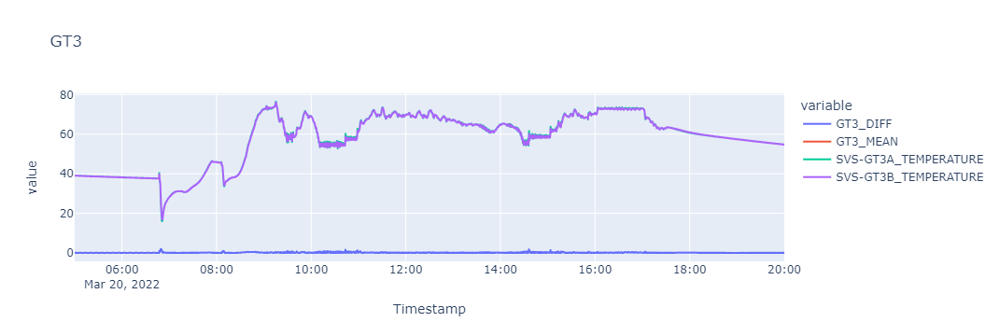

Mean diff:  57.51950438535431


In [5]:
df_broad['GT3_MEAN']=df_broad[['SVS-GT3A_TEMPERATURE','SVS-GT3B_TEMPERATURE']].mean(axis=1)
df_broad['GT3_DIFF']=abs(df_broad['SVS-GT3A_TEMPERATURE']-df_broad['SVS-GT3B_TEMPERATURE'])

fig = px.line(df_broad, x=df_broad.index, y=['GT3_DIFF','GT3_MEAN','SVS-GT3A_TEMPERATURE','SVS-GT3B_TEMPERATURE'],
                title="GT3")
fig.show()

print('Mean diff: ',df_broad['GT3_MEAN'].mean())

#### Look at GT1

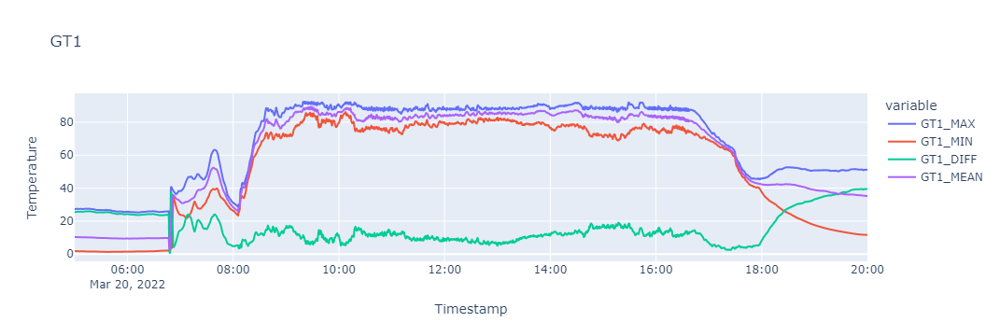

In [6]:
df_broad['GT1_MIN'] = df_broad[['SVS-GT1:1_TEMPERATURE', 'SVS-GT1:2_TEMPERATURE',
       'SVS-GT1:3_TEMPERATURE', 'SVS-GT1:4_TEMPERATURE',
       'SVS-GT1:5_TEMPERATURE', 'SVS-GT1:6_TEMPERATURE',
       'SVS-GT1:7_TEMPERATURE', 'SVS-GT1:8_TEMPERATURE']].min(axis=1)
df_broad['GT1_MAX'] = df_broad[['SVS-GT1:1_TEMPERATURE', 'SVS-GT1:2_TEMPERATURE',
       'SVS-GT1:3_TEMPERATURE', 'SVS-GT1:4_TEMPERATURE',
       'SVS-GT1:5_TEMPERATURE', 'SVS-GT1:6_TEMPERATURE',
       'SVS-GT1:7_TEMPERATURE', 'SVS-GT1:8_TEMPERATURE']].max(axis=1)
df_broad['GT1_MEAN'] = df_broad[['SVS-GT1:1_TEMPERATURE', 'SVS-GT1:2_TEMPERATURE',
       'SVS-GT1:3_TEMPERATURE', 'SVS-GT1:4_TEMPERATURE',
       'SVS-GT1:5_TEMPERATURE', 'SVS-GT1:6_TEMPERATURE',
       'SVS-GT1:7_TEMPERATURE', 'SVS-GT1:8_TEMPERATURE']].mean(axis=1)

df_broad['GT1_DIFF'] = df_broad['GT1_MAX'] - df_broad['GT1_MIN']

fig = px.line(df_broad, x=df_broad.index, y=['GT1_MAX', 'GT1_MIN','GT1_DIFF','GT1_MEAN'],
              labels={"value":"Temperature",},
                title="GT1")
fig.show()

#### Determine value of $T_m$ 

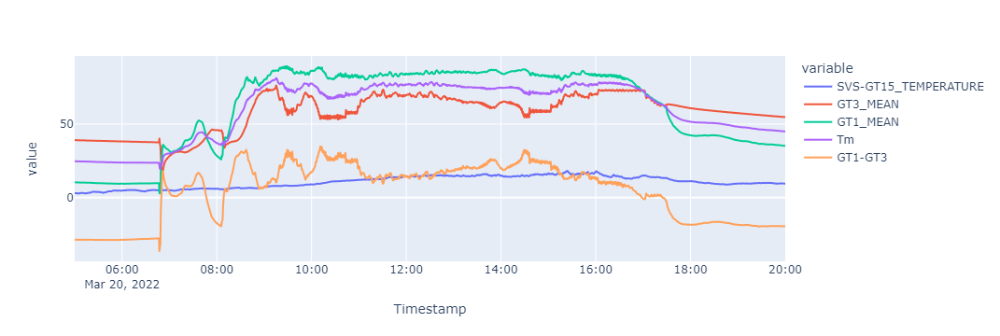

In [7]:
df_broad['Tm'] = df_broad[['GT1_MEAN','GT3_MEAN']].mean(axis=1)
df_broad['GT1-GT3'] = df_broad['GT1_MEAN'] - df_broad['GT3_MEAN']

fig = px.line(df_broad, x=df_broad.index, y=['SVS-GT15_TEMPERATURE','GT3_MEAN','GT1_MEAN','Tm','GT3_MEAN','GT1-GT3'])
fig.show()

### Irradiance

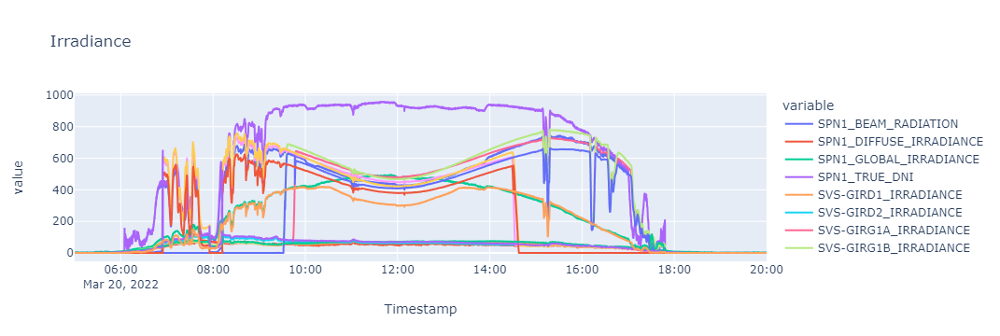

In [8]:
fig = px.line(df_broad, x=df_broad.index, y=['SPN1_BEAM_RADIATION', 'SPN1_DIFFUSE_IRRADIANCE',
       'SPN1_GLOBAL_IRRADIANCE', 'SPN1_TRUE_DNI','SVS-GIRD1_IRRADIANCE','SVS-GIRD2_IRRADIANCE','SVS-GIRG1A_IRRADIANCE',
       'SVS-GIRG1B_IRRADIANCE', 'SVS-GIRG2A_IRRADIANCE', 'SVS-GIRG2B_IRRADIANCE','SVS_BEAM_RADIATION_1', 'SVS_BEAM_RADIATION_2',
       'SVS_DIFFUSE_RADIATION_1', 'SVS_DIFFUSE_RADIATION_2', 'SVS_HIGHEST_DNI'],
                title="Irradiance")
fig.show()



In [9]:
df_broad['SVS-GIRG2A_IRRADIANCE']*

fig = px.line(df_broad, x=df_broad.index, y=['SVS-GIRD2_IRRADIANCE','SVS-GIRG1A_IRRADIANCE',
       'SVS-GIRG1B_IRRADIANCE', 'SVS-GIRG2A_IRRADIANCE', 'SVS-GIRG2B_IRRADIANCE','SVS_BEAM_RADIATION_1', 'SVS_BEAM_RADIATION_2',
       'SVS_DIFFUSE_RADIATION_1', 'SVS_DIFFUSE_RADIATION_2'],
                title="Irradiance")
fig.show()

SyntaxError: invalid syntax (Temp/ipykernel_18964/1644203450.py, line 1)

In [ ]:
GIRG_A_cos = df_broad['SVS-GIRG1A_IRRADIANCE'] * df_broad['r_shading']# Kb #* np.cos(np.deg2rad(df_broad['theta_angle']))

GIRG_A_mean = df_broad[['SVS-GIRG1A_IRRADIANCE','SVS-GIRG1B_IRRADIANCE']].mean(axis=1)

fig = px.line(df_broad, x=df_broad.index, y=[GIRG_A_mean,'SVS-GIRG1A_IRRADIANCE','SVS-GIRG1B_IRRADIANCE','SVS_BEAM_RADIATION_1',
       'SVS_DIFFUSE_RADIATION_1'], labels = {'value':'Irradiance [W/m2]'},
                title="Irradiance")
fig.show()


In [ ]:
Kb = np.array([IAM_qdt(angle) for angle in truetracking_angles['aoi']]) 
Kb2 = df_broad['IAM_factor']

SPN1_DNI = (df_broad['SPN1_GLOBAL_IRRADIANCE']*np.cos(np.deg2rad(df_broad['theta_angle'])) + df_broad['SPN1_DIFFUSE_IRRADIANCE'])*df_broad['r_shading']*Kb
mean_DNI = df_broad[['SVS_BEAM_RADIATION_1','SVS_BEAM_RADIATION_2','SPN1_BEAM_RADIATION']].mean(axis=1) 
max_DNI = df_broad[['SVS_BEAM_RADIATION_1','SVS_BEAM_RADIATION_2','SPN1_BEAM_RADIATION']].max(axis=1)#*df_broad['r_shading']*Kb2


true_DNI2 = max_DNI/np.cos(np.deg2rad(df_broad['theta_angle']))

GHI = (df_broad['SPN1_BEAM_RADIATION']+ df_broad['SPN1_DIFFUSE_IRRADIANCE']) * 
fig = px.line(df_broad, x=df_broad.index, y=[GHI,'SPN1_BEAM_RADIATION', 'SPN1_DIFFUSE_IRRADIANCE',
       'SPN1_GLOBAL_IRRADIANCE', 'SPN1_TRUE_DNI','SVS_HIGHEST_DNI_shaded_w_IAM','SPN1_GLOBAL_IRRADIANCE'],
                title="Irradiance")
fig.show()

In [ ]:
Kb2 = df_broad['IAM_factor']


plt.plot(df_broad.index,Kb,label='Min')
plt.plot(df_broad.index,Kb2,label='Dashboard')

In [ ]:
len(SPN1_DNI)

In [ ]:
df_broad['SVS_DIFFUSE_MAX'] = df_broad[['SVS_DIFFUSE_RADIATION_1', 'SVS_DIFFUSE_RADIATION_2']].max(axis=1)
fig = px.line(df_broad, x=df_broad.index, y=['SVS_DIFFUSE_MAX','SPN1_DIFFUSE_IRRADIANCE'],
                title="Diffuse Irradiance")
fig.show()

### Other Interesting aspects

In [ ]:
fig = px.line(df_broad, x=df_broad.index, y=['FJV_P2_ONOFF','r_shading'],
                title="")
fig.show()

Between 8:51:56 and 17:28:56 is the DH-grid pump turned on, meaning heat is delivered to the network throughout this period. 

Vi ser också lite av trögheten i systemet. Lång tid innan pumpen slås på. 

### Tracking Angles

In [ ]:
fig = px.line(df_broad, x=df_broad.index, y=['col_ang0', 'col_ang1', 'col_ang10', 'col_ang11','col_ang12', 
                                             'col_ang13', 'col_ang14', 'col_ang15','col_ang2','col_ang3', 
                                             'col_ang4', 'col_ang5', 'col_ang6', 'col_ang7', 'col_ang8','col_ang9'],
                title="Tracking Angles")
fig.show()


df_broad['col_ang_STD'] = df_broad[['col_ang0', 'col_ang1', 'col_ang10', 'col_ang11','col_ang12', 
                                             'col_ang13', 'col_ang14', 'col_ang15','col_ang2','col_ang3', 
                                             'col_ang4', 'col_ang5', 'col_ang6', 'col_ang7', 'col_ang8','col_ang9']].std(axis=1)
df_broad['col_ang_MEAN'] = df_broad[['col_ang0', 'col_ang1', 'col_ang10', 'col_ang11','col_ang12', 
                                             'col_ang13', 'col_ang14', 'col_ang15','col_ang2','col_ang3', 
                                             'col_ang4', 'col_ang5', 'col_ang6', 'col_ang7', 'col_ang8','col_ang9']].mean(axis=1)


In [10]:
diff = np.zeros((len(df_broad),16))

cols = ['col_ang0', 'col_ang1', 'col_ang10', 'col_ang11','col_ang12','col_ang13', 'col_ang14', 'col_ang15','col_ang2','col_ang3',
        'col_ang4', 'col_ang5', 'col_ang6', 'col_ang7', 'col_ang8','col_ang9']
mean = np.array(df_broad['col_ang_MEAN'])
for i in range(len(cols)):
    print(cols[i])
    col = cols[i]
    diff[:,i] = np.array(df_broad[col]-mean)
    for i in rande
plt.plot(diff[:,0])

SyntaxError: invalid syntax (Temp/ipykernel_18964/1734788065.py, line 10)

In [ ]:
df_broad 

## Look at Pvlib

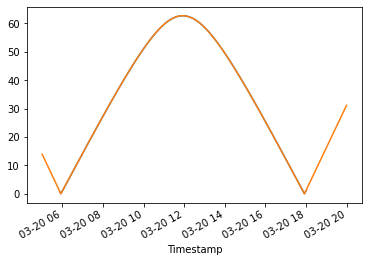

In [11]:
from pvlib import solarposition, tracking
import pandas as pd
import matplotlib.pyplot as plt

tz = 'Europe/Stockholm'

lat, lon = 62.6329, 17.938 # degrees

#times = df_astrasys.index
times = df_broad.index

solpos = solarposition.get_solarposition(times, lat, lon)

truetracking_angles = tracking.singleaxis(
    apparent_zenith=solpos['apparent_zenith'],
    apparent_azimuth=solpos['azimuth'],
    axis_tilt=0,
    axis_azimuth=180,
    max_angle=90,
    backtrack=False,  # for true-tracking
    gcr=0.5)  # irrelevant for true-tracking

# truetracking_angles['aoi'] is the angle of incidence
truetracking_angles['aoi'].plot()
df_broad['theta_angle'].plot()

df_broad['aoi'] = truetracking_angles['aoi']

<AxesSubplot:xlabel='Timestamp'>

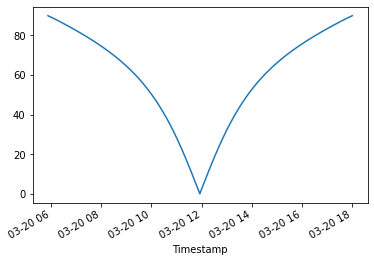

In [12]:
truetracking_angles['surface_tilt'].plot()

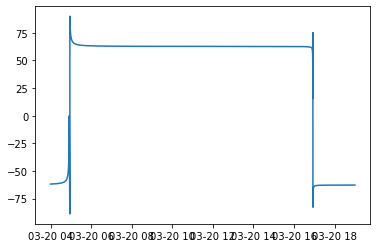

In [21]:
tan_beta = np.rad2deg(np.arctan(np.tan(np.deg2rad(solpos['zenith']))*abs(np.cos(np.deg2rad(solpos['azimuth']-180)))))
plt.plot(tan_beta)


## Implementation of QDT-model
As given by the QDT-model

In [ ]:
QDT_IAM = [1.00, 0.99, 0.98, 0.96, 0.90, 0.80, 0.64,
           0.43, 0.21, 0.00]
SS_IAM = [1.00, 0.99, 0.99, 0.98, 0.96, 0.91, 0.77, 0.53, 
          0.18, 0.00]
Angles = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90] #zenith angles
IAM_df = pd.DataFrame({#'Angle':Angles,
                       'QDT-method':QDT_IAM,
                      'SS-method':SS_IAM}, index = Angles)

IAM_df.index.names = ['Angle']

IAM_df.T

In [ ]:
# Use degree X of polynomial for fit
def IAM_qdt(angle):
    Angles = IAM_df.index
    IAM = IAM_df['QDT-method']
    if angle < 90:
        k = np.polyfit(Angles,IAM,5)
        p = np.poly1d(k)
    else:
        p = lambda angle: 0  
    return p(angle)

def dTdt(df):
    diff = np.zeros(len(df-1))
    for i in range(1,len(df)):
        dT = float(df['Tm'][i]-df['Tm'][i-1])
        dt = (df.index[i] - df.index[i-1])
        dt = np.timedelta64(dt,'s').astype(int)
        diff[i-1] = dT/dt
    #plt.plot(df_broad.index,dTdt)
    return  diff

def Q_sqm(df):
    #Def. global variables
    a1,a2,a3,a4,a5,a6,a7,a8, Kd,etab = 0.73,0.000,0.000,0.00, 1483, 0.000, 0.00, 0.00, 0.12,0.697

    #Ag = 6.04 % For I collector
    Ag = 1058 # for entire collector field

    # Kb = 'SVS_HIGHEST_DNI'
    #Kb = np.array([IAM_qdt(angle) for angle in truetracking_angles['aoi']]) 
    #Kb = df['IAM_factor']
    Gb = df['SVS_HIGHEST_DNI_shaded_w_IAM']
    Gd = np.array(df['SVS_DIFFUSE_MAX']) 
    
    Q = ((etab*Gb)+(etab*Gd*Kd)-(a1*(df['Tm']-df['SVS-GT15_TEMPERATURE']))
         -(a2*(df['Tm']-df['SVS-GT15_TEMPERATURE'])**2)+ a5*dTdt(df))
    return np.clip(Q,a_min=0,a_max=None)

def Q_sqm2(df):
    #Def. global variables
    a1,a2,a3,a4,a5,a6,a7,a8, Kd,etab = 0.73,0.000,0.000,0.00, 1483, 0.000, 0.00, 0.00, 0.12,0.697

    #Ag = 6.04 % For I collector
    Ag = 1058 # for entire collector field

    # Kb = 'SVS_HIGHEST_DNI'
    #Kb = np.array([IAM_qdt(angle) for angle in truetracking_angles['aoi']]) 
    Kb = df['IAM_factor']
    Gb = df['SVS_HIGHEST_DNI']*df_broad['r_shading'] # shading accounted for
    Gd = np.array(df['SVS_DIFFUSE_MAX']) #df_broad['SVS_DIFFUSE_MAX']
    
    Q = ((etab*Gb*Kb)+(etab*Kd*Gd)-(a1*(df['Tm']-df['SVS-GT15_TEMPERATURE']))
         -(a2*(df['Tm']-df['SVS-GT15_TEMPERATURE'])**2)+ a5*dTdt(df))/Ag
    return np.clip(Q,a_min=0,a_max=None)

def Q_sqm_Dashboard_IAM(df):
    #Def. global variables
    a1,a2,a3,a4,a5,a6,a7,a8, Kd,etab = 0.73,0.000,0.000,0.00, 1483, 0.000, 0.00, 0.00, 0.12,0.697

    #Ag = 6.04 % For I collector
    Ag = 1058 # for entire collector field

    # Kb = 'SVS_HIGHEST_DNI'
    #Kb = np.array([IAM_qdt(angle) for angle in truetracking_angles['aoi']]) 
    Kb = df['IAM_factor']
    Gb = df['SVS_HIGHEST_DNI']#*df['r_shading'] # shading and IAM already accounted for in'SVS_HIGHEST_DNI'
    Gd = np.array(df['SVS_DIFFUSE_MAX']) #df_broad['SVS_DIFFUSE_MAX']
    
    Q = ((etab*Gb*Kb)+(etab*Kd*Gd)-(a1*(df['Tm']-df['SVS-GT15_TEMPERATURE']))
         -(a2*(df['Tm']-df['SVS-GT15_TEMPERATURE'])**2)+ a5*dTdt(df))
    return np.clip(Q,a_min=0,a_max=None)

def Q_sqm_own_IAM(df):
    max_DNI = df[['SVS_BEAM_RADIATION_1','SVS_BEAM_RADIATION_2','SPN1_BEAM_RADIATION']].max(axis=1)
    
    #Def. global variables
    a1,a2,a3,a4,a5,a6,a7,a8, Kd,etab = 0.73,0.000,0.000,0.00, 1483, 0.000, 0.00, 0.00, 0.12,0.697
    #Ag = 6.04 % For 1 collector
    Ag = 1058 # for entire collector field

    Kb = np.array([IAM_qdt(angle) for angle in truetracking_angles['aoi']]) 
    #Kb = df['IAM_factor']
    Gb = max_DNI*df['r_shading'] # shading accounted for
    Gd = np.array(df_broad['SVS_DIFFUSE_MAX']) #'SPN1_DIFFUSE_IRRADIANCE'
    
    Q = ((etab*Gb*Kb)+(etab*Kd*Gd)-(a1*(df['Tm']-df['SVS-GT15_TEMPERATURE']))
         -(a2*(df['Tm']-df['SVS-GT15_TEMPERATURE'])**2)+ a5*dTdt(df))
    return np.clip(Q,a_min=0,a_max=None)



q_sqm = Q_sqm(df_broad)
q_sqm2 = Q_sqm2(df_broad)
q_sqm_d = Q_sqm_own_IAM(df_broad)
q_sqm_own = Q_sqm_Dashboard_IAM(df_broad)

In [ ]:
fig = px.line(df_broad, x=df_broad.index, y=['SVS_POWER_GT1GT3', 'SVS_QDT_calculated_power_per_m2', 'SVS_QDT_calculated_total_power',q_sqm,q_sqm_own,q_sqm_d],
                title="Diffuse Irradiance")
fig.show()

Dashboards 'SVS_POWER_GT1GT3_PER_SQM' inte rimlig. Har räknat 
power/square meters as $Q/A^2$

In [ ]:
plt.plot(df_broad.index,df_broad['SVS_POWER_GT1GT3_PER_SQM'],label='SVS_POWER_GT1GT3_PER_SQM')
plt.plot(df_broad.index,q_sqm2,label='q_sqm2')
plt.grid(axis='both',which='major',color=[166/255,166/255,166/255], linestyle='-', linewidth=1)
plt.legend()

In [ ]:
'SVS_POWER_GT1GT3', 'SVS_POWER_GT1GT3_PER_SQM',
       'SVS_QDT_calculated_power_per_m2', 'SVS_QDT_calculated_total_power',

In [ ]:
df = df_broad[df_broad['FJV_P2_ONOFF'] > 0]
df['FJV_P2_ONOFF'].plot()


In [ ]:
q_sqm = Q_sqm(df)
q_sqm2 = Q_sqm2(df)
q_sqm_d = Q_sqm_own_IAM(df)
q_sqm_own = Q_sqm_Dashboard_IAM(df)

fig = px.line(df_broad, x=df_broad.index, y=['SVS_POWER_GT1GT3', 'SVS_QDT_calculated_power_per_m2', 'SVS_QDT_calculated_total_power',q_sqm,q_sqm_own,q_sqm_d],
                title="Diffuse Irradiance")
fig.show()

In [ ]:
for [index in truetracking_angles.index if index in df.index]

In [ ]:
df.iloc[2:5]